In [23]:
import pandas as pd
import gzip
import json

In [2]:
print("hello")

hello


In [3]:
def parseZip(path):
  zip = gzip.open(path, 'rb')
  for content in zip:
    yield json.loads(content)

In [4]:
#1 Saving data into dataFrame

def getFillUpDF(path):
  dataframe = {}
  i = 0
  for content in parseZip(path):
    dataframe[i] = content
    i += 1
  return pd.DataFrame.from_dict(dataframe, orient='index')

In [5]:
df = getFillUpDF('Electronics_5.json.gz')

In [6]:
# df

In [7]:
df.to_pickle("ElectronicsDf.pkl")

In [8]:
ElectronicsDf = pd.read_pickle("ElectronicsDf.pkl")

In [9]:
ElectronicsDf

,overall,vote,verified,reviewTime,reviewerID,asin,style,reviewerName,reviewText,summary,unixReviewTime,image
0,5.0,67,True,"09 18, 1999",AAP7PPBU72QFM,0151004714,{'Format:': ' Hardcover'},D. C. Carrad,This is the best novel I have read in 2 or 3 y...,A star is born,937612800,NaN
1,3.0,5,True,"10 23, 2013",A2E168DTVGE6SV,0151004714,{'Format:': ' Kindle Edition'},Evy,"Pages and pages of introspection, in the style...",A stream of consciousness novel,1382486400,NaN
2,5.0,4,False,"09 2, 2008",A1ER5AYS3FQ9O3,0151004714,{'Format:': ' Paperback'},Kcorn,This is the kind of novel to read when you hav...,I'm a huge fan of the author and this one did ...,1220313600,NaN
3,5.0,13,False,"09 4, 2000",A1T17LMQABMBN5,0151004714,{'Format:': ' Hardcover'},Caf Girl Writes,What gorgeous language! What an incredible wri...,The most beautiful book I have ever read!,968025600,NaN
4,3.0,8,True,"02 4, 2000",A3QHJ0FXK33OBE,0151004714,{'Format:': ' Hardcover'},W. Shane Schmidt,I was taken in by reviews that compared this b...,A dissenting view--In part.,949622400,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
6739585,4.0,NaN,True,"03 21, 2017",A33MAQA919J2V8,B01HJH40WU,NaN,Kurt Wurm,"These seem like quality USB cables, time will ...",Four Stars,1490054400,NaN
6739586,4.0,NaN,True,"01 9, 2017",A1AKHSCPD1BHM4,B01HJH40WU,NaN,C.L Momof3,"Works great, love the longer cord. As with any...",Nice long cord,1483920000,NaN
6739587,5.0,2,True,"12 1, 2016",A2HUZO7MQAY5I2,B01HJH40WU,NaN,michael clontz,"Ok here is an odd thing that happened to me, I...",Not the correct product as linked in the sale.,1480550400,NaN
6739588,5.0,2,True,"11 29, 2016",AJJ7VX2L91X2W,B01HJH40WU,NaN,Faith,Works well.,Five Stars,1480377600,NaN


In [10]:
# len(ElectronicsDf)

In [11]:
ElectronicsMetaDf = getFillUpDF('meta_Electronics.json.gz')

In [12]:
# ElectronicsMetaDf

In [13]:
ElectronicsMetaDf.to_pickle("ElectronicMetaDF.pkl")

In [2]:
ElectronicsMetaDf = pd.read_pickle("ElectronicMetaDF.pkl")

In [3]:
len(ElectronicsMetaDf)

786445

In [16]:
ElectronicsMetaDf['title'] = ElectronicsMetaDf['title'].str.lower()

In [17]:
# 2
FilteredElectronicsMetaDf = ElectronicsMetaDf[ElectronicsMetaDf['title'].str.contains('headphones | headphone', case= False)]

In [18]:
# FilteredElectronicsMetaDf

In [19]:
# len(FilteredElectronicsMetaDf)

In [20]:
# FilteredElectronicsMetaDf.isna().sum()

In [21]:
PreProcesses_Filtered_ElectronicsMetaDf = FilteredElectronicsMetaDf.copy()

In [22]:
#citation:- https://stackoverflow.com/a/43855963
PreProcesses_Filtered_ElectronicsMetaDf = PreProcesses_Filtered_ElectronicsMetaDf.loc[PreProcesses_Filtered_ElectronicsMetaDf.astype(str).drop_duplicates().index]

In [23]:
# len(PreProcesses_Filtered_ElectronicsMetaDf)

In [24]:
# PreProcesses_Filtered_ElectronicsMetaDf.to_pickle("PreProcesses_Filtered_ElectronicsMetaDf.pkl")

In [25]:
PreProcesses_Filtered_ElectronicsMetaDf.to_pickle("PreProcesses_Filtered_ElectronicsMetaDf_V2.0.pkl")

In [2]:
PreProcesses_Filtered_ElectronicsMetaDf = pd.read_pickle("PreProcesses_Filtered_ElectronicsMetaDf_V2.0.pkl")

In [3]:
PreProcesses_Filtered_ElectronicsMetaDf

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
8,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>True High Definition Sound:</b><br>With ...",,wireless bluetooth headphones earbuds with mic...,[],,Enter The Arena,[Superb Sound Quality: Plays crystal clear aud...,[>#950 in Cell Phones & Accessories (See Top 1...,[],Home Audio & Theater,,"October 23, 2017",$7.99,0132492776,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
47,"[Electronics, Headphones]",,[Use these high quality headphones for interne...,,polaroid pbm2200 pc / gaming stereo headphones...,[],,Polaroid,"[Ideal for PC Internet chatting, PC / Console ...","[>#3,548,269 in Cell Phones &amp; Accessories ...",[],All Electronics,,"December 13, 2012",,0558835155,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
132,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>True High Definition Sound:</b><br>With ...",,bluetooth workout headphones for running and g...,[],,Enter The Arena,[Superb Sound Quality: Plays crystal clear aud...,"[>#4,626,934 in Cell Phones & Accessories (See...",[],Home Audio & Theater,,"December 28, 2015",,0692206280,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
223,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>True High Definition Sound:</b><br />Wit...",,bluetooth workout headphones for running and g...,[],,Enter The Arena,[Superb Sound Quality: Plays crystal clear aud...,"[>#2,654,020 in Cell Phones &amp; Accessories ...",[],Home Audio &amp; Theater,,"October 18, 2015",,0983629269,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
229,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>True High Definition Sound:</b><br />Wit...",,bluetooth workout headphones for running and g...,[],,Enter The Arena,[Superb Sound Quality: Plays crystal clear aud...,"[>#5,289,289 in Cell Phones &amp; Accessories ...",[],Home Audio &amp; Theater,,"April 26, 2013",,0985262788,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
786395,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>Specification</b></br> Driver: 5mm</br> ...",,maxrock noise isolating sleeping headphones ea...,[],,MAXROCK,"[Unique patented silicone design headphones, s...","[>#21,087 in Musical Instruments (See Top 100 ...","[B071WRSL38, B00XCDOGY8, B00V9FN1R4, B00SRAV6V...",Musical Instruments,"class=""a-bordered a-horizontal-stripes a-spa...","June 25, 2016",,B01HJAVYDU,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,{}
786400,"[Electronics, Accessories & Supplies, Audio & ...",,"[, <b>Compatible Headphones:</b><br>- SONY MDR...",,geekria&reg; elite headphone shoulder bag / ca...,[],,Geekria,"[Saffiano Leather, lightweight and fashionable...","[>#4,760 in Electronics > Accessories & Suppli...","[B0796LWMCR, B019Z81V3M, B00TBELD02, B01CJJ2IF...",Home Audio & Theater,"class=""a-bordered a-horizontal-stripes a-spa...",,$1.86,B01HJA2TV6,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,{}
786404,"[Electronics, Headphones, Earbud Headphones]",,[About the product Rhapsody & Mogan H9 is a m...,,"wireless bluetooth headset, handsfree wireless...",[],,snorain,[COMFORTABLE CUSTOM FIT Rhapsody & Mogan nois...,"[>#343,752 in Cell Phones & Accessories (See T...","[B01D3QZB2Y, B079GFF4HZ, B00XBZY0EI, B00S2P0M1...",All Electronics,"class=""a-bordered a-horizontal-stripes a-spa...","June 25, 2016",,B01HJAPNHI,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,{}
786405,"[Electronics, Headphones,

In [28]:
HeadPhones_df = pd.DataFrame()
for product_id in PreProcesses_Filtered_ElectronicsMetaDf["asin"]:
    HeadPhones_df = pd.concat([HeadPhones_df, ElectronicsDf[(ElectronicsDf["asin"] == product_id)]], ignore_index = True) 

In [29]:
# len(HeadPhones_df)

In [30]:
HeadPhones_df.to_pickle("HeadPhones_reviews_df.pkl")

In [22]:
HeadPhones_df = pd.read_pickle("HeadPhones_reviews_df.pkl")

In [7]:
HeadPhones_df

,overall,vote,verified,reviewTime,reviewerID,asin,style,reviewerName,reviewText,summary,unixReviewTime,image
0,5.0,NaN,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,{'Color:': ' Blue W/Mic'},George Walker,Great headphones. It's just the cord is too sh...,Five Stars,1424563200,NaN
1,5.0,NaN,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,{'Color:': ' Blue Zebra W/Mic'},Carolyn B,Really like these headphone. Wanted something...,Officewear,1494201600,NaN
2,1.0,NaN,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,{'Color:': ' Blue W/Mic'},MK,Wire to headphone broke off in less than a mon...,For the money they are fine. Just hope they ho...,1478304000,NaN
3,3.0,NaN,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,{'Color:': ' Green'},bigboy,Very good,Three Stars,1474675200,NaN
4,1.0,NaN,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,{'Color:': ' Violet Purple'},Kelly Hales,Currently returning this product because the s...,Currently returning this product because the s...,1468713600,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
423041,5.0,2,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,{'Color:': ' Black'},charles h evans,Bought this on a flash sale and it's excellent...,"Good holder, simple and functional",1473292800,NaN
423042,4.0,NaN,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,{'Color:': ' Black'},Cheryl Showalters,This is excellent especially for the price.,works great and the price is excellent. Holds...,1470960000,NaN
423043,4.0,NaN,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,{'Color:': ' White'},CD,I have only used these for 1 week at the time ...,They work...,1537574400,NaN
423044,3.0,NaN,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,{'Color:': ' White'},Jay Salamon,"The product works great, but when it gets down...",30% charge shuts the device off,1536710400,NaN


In [8]:
HeadPhones_df.isna().sum()

overall                0
vote              364987
verified               0
reviewTime             0
reviewerID             0
asin                   0
style             153493
reviewerName          61
reviewText            53
summary               72
unixReviewTime         0
image             414787
dtype: int64

In [9]:
len(HeadPhones_df)

423046

In [35]:
# PreProcesses_HeadPhones_df.to_pickle("PreProcesses_HeadPhones_df.pkl")

In [36]:
# PreProcesses_HeadPhones_df.to_pickle("PreProcesses_HeadPhones_df_V2.0.pkl")

In [37]:
# PreProcesses_HeadPhones_df = pd.read_pickle("PreProcesses_HeadPhones_df.pkl")

In [38]:
# PreProcesses_HeadPhones_df = pd.read_pickle("PreProcesses_HeadPhones_df_V2.0.pkl")

In [39]:
# PreProcesses_HeadPhones_df.isna().sum()

In [50]:
PreProcesses_HeadPhones_df = HeadPhones_df.copy()

In [51]:
PreProcesses_HeadPhones_df

,overall,vote,verified,reviewTime,reviewerID,asin,style,reviewerName,reviewText,summary,unixReviewTime,image
0,5.0,NaN,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,{'Color:': ' Blue W/Mic'},George Walker,Great headphones. It's just the cord is too sh...,Five Stars,1424563200,NaN
1,5.0,NaN,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,{'Color:': ' Blue Zebra W/Mic'},Carolyn B,Really like these headphone. Wanted something...,Officewear,1494201600,NaN
2,1.0,NaN,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,{'Color:': ' Blue W/Mic'},MK,Wire to headphone broke off in less than a mon...,For the money they are fine. Just hope they ho...,1478304000,NaN
3,3.0,NaN,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,{'Color:': ' Green'},bigboy,Very good,Three Stars,1474675200,NaN
4,1.0,NaN,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,{'Color:': ' Violet Purple'},Kelly Hales,Currently returning this product because the s...,Currently returning this product because the s...,1468713600,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
423041,5.0,2,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,{'Color:': ' Black'},charles h evans,Bought this on a flash sale and it's excellent...,"Good holder, simple and functional",1473292800,NaN
423042,4.0,NaN,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,{'Color:': ' Black'},Cheryl Showalters,This is excellent especially for the price.,works great and the price is excellent. Holds...,1470960000,NaN
423043,4.0,NaN,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,{'Color:': ' White'},CD,I have only used these for 1 week at the time ...,They work...,1537574400,NaN
423044,3.0,NaN,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,{'Color:': ' White'},Jay Salamon,"The product works great, but when it gets down...",30% charge shuts the device off,1536710400,NaN


In [52]:
len(PreProcesses_HeadPhones_df)

423046

In [53]:
PreProcesses_HeadPhones_df.isna().sum()

overall                0
vote              364987
verified               0
reviewTime             0
reviewerID             0
asin                   0
style             153493
reviewerName          61
reviewText            53
summary               72
unixReviewTime         0
image             414787
dtype: int64

In [54]:
PreProcesses_HeadPhones_df = PreProcesses_HeadPhones_df.drop(columns= ["vote","style","image"])

In [55]:
PreProcesses_HeadPhones_df = PreProcesses_HeadPhones_df.loc[PreProcesses_HeadPhones_df.astype(str).drop_duplicates().index]

In [56]:
PreProcesses_HeadPhones_df = PreProcesses_HeadPhones_df.dropna(subset=['reviewText'])

In [57]:
PreProcesses_HeadPhones_df

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime
0,5.0,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,George Walker,Great headphones. It's just the cord is too sh...,Five Stars,1424563200
1,5.0,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,Carolyn B,Really like these headphone. Wanted something...,Officewear,1494201600
2,1.0,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,MK,Wire to headphone broke off in less than a mon...,For the money they are fine. Just hope they ho...,1478304000
3,3.0,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,bigboy,Very good,Three Stars,1474675200
4,1.0,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,Kelly Hales,Currently returning this product because the s...,Currently returning this product because the s...,1468713600
...,...,...,...,...,...,...,...,...,...
423041,5.0,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,charles h evans,Bought this on a flash sale and it's excellent...,"Good holder, simple and functional",1473292800
423042,4.0,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,Cheryl Showalters,This is excellent especially for the price.,works great and the price is excellent. Holds...,1470960000
423043,4.0,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,CD,I have only used these for 1 week at the time ...,They work...,1537574400
423044,3.0,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,Jay Salamon,"The product works great, but when it gets down...",30% charge shuts the device off,1536710400


In [48]:
# PreProcesses_HeadPhones_df = PreProcesses_HeadPhones_df.sample(n=10000)

In [58]:
PreProcesses_HeadPhones_df.to_pickle("PreProcesses_HeadPhones_df_V2.0.pkl")

In [3]:
PreProcesses_HeadPhones_df = pd.read_pickle("PreProcesses_HeadPhones_df_V2.0.pkl")

In [60]:
PreProcesses_HeadPhones_df.isna().sum()

overall            0
verified           0
reviewTime         0
reviewerID         0
asin               0
reviewerName      54
reviewText         0
summary           72
unixReviewTime     0
dtype: int64

In [61]:
PreProcesses_HeadPhones_df

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime
0,5.0,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,George Walker,Great headphones. It's just the cord is too sh...,Five Stars,1424563200
1,5.0,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,Carolyn B,Really like these headphone. Wanted something...,Officewear,1494201600
2,1.0,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,MK,Wire to headphone broke off in less than a mon...,For the money they are fine. Just hope they ho...,1478304000
3,3.0,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,bigboy,Very good,Three Stars,1474675200
4,1.0,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,Kelly Hales,Currently returning this product because the s...,Currently returning this product because the s...,1468713600
...,...,...,...,...,...,...,...,...,...
423041,5.0,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,charles h evans,Bought this on a flash sale and it's excellent...,"Good holder, simple and functional",1473292800
423042,4.0,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,Cheryl Showalters,This is excellent especially for the price.,works great and the price is excellent. Holds...,1470960000
423043,4.0,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,CD,I have only used these for 1 week at the time ...,They work...,1537574400
423044,3.0,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,Jay Salamon,"The product works great, but when it gets down...",30% charge shuts the device off,1536710400


In [62]:
PreProcesses_HeadPhones_df = PreProcesses_HeadPhones_df.reset_index(drop=True)

In [63]:
PreProcesses_HeadPhones_df

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime
0,5.0,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,George Walker,Great headphones. It's just the cord is too sh...,Five Stars,1424563200
1,5.0,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,Carolyn B,Really like these headphone. Wanted something...,Officewear,1494201600
2,1.0,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,MK,Wire to headphone broke off in less than a mon...,For the money they are fine. Just hope they ho...,1478304000
3,3.0,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,bigboy,Very good,Three Stars,1474675200
4,1.0,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,Kelly Hales,Currently returning this product because the s...,Currently returning this product because the s...,1468713600
...,...,...,...,...,...,...,...,...,...
389710,5.0,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,charles h evans,Bought this on a flash sale and it's excellent...,"Good holder, simple and functional",1473292800
389711,4.0,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,Cheryl Showalters,This is excellent especially for the price.,works great and the price is excellent. Holds...,1470960000
389712,4.0,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,CD,I have only used these for 1 week at the time ...,They work...,1537574400
389713,3.0,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,Jay Salamon,"The product works great, but when it gets down...",30% charge shuts the device off,1536710400


In [64]:
# 4
Number_of_Reviews = len(PreProcesses_HeadPhones_df)

In [65]:
Number_of_Reviews

389715

In [66]:
ratings = []
for rating in PreProcesses_HeadPhones_df["overall"]:
    ratings.append(rating)

sum_of_ratings = sum(ratings) 
Average_Rating_Score = sum_of_ratings / len(ratings)

In [67]:
Average_Rating_Score

4.1018718807333565

In [68]:
Number_of_Unique_Products = len(PreProcesses_Filtered_ElectronicsMetaDf)

In [69]:
Number_of_Unique_Products

26434

In [70]:
Number_of_Good_Rating = len(PreProcesses_HeadPhones_df[(PreProcesses_HeadPhones_df["overall"] >= 3)])

In [71]:
Number_of_Good_Rating

334110

In [72]:
Number_of_Bad_Ratings = len(ratings) - Number_of_Good_Rating

In [73]:
Number_of_Bad_Ratings

55605

In [74]:
# Number of Reviews corresponding to each Rating.
PreProcesses_HeadPhones_df["overall"].value_counts()

5.0    219798
4.0     75234
3.0     39078
1.0     29809
2.0     25796
Name: overall, dtype: int64

In [66]:
# 5
# Reviews 
    # reviewText
    # summary
# MetaData
   # description
   # feature
   # title
   # brand
   # categories

In [75]:
from bs4 import BeautifulSoup
import unidecode
import nltk 
nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer 
lemmatizer = WordNetLemmatizer() 
import string
import re

[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\hp\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [76]:
def preprocessText(text):
   Html_free_text =  BeautifulSoup(text,"html.parser").text
   Accent_removed_text = unidecode.unidecode(Html_free_text)
   # Special_char_removed_text = ''.join(character for character in Accent_removed_text if character.isalnum())
   Special_char_removed_text = re.sub(r'[^a-zA-Z0-9\s]', '', Accent_removed_text)   
   tokens = nltk.word_tokenize(Special_char_removed_text) 
   lemetized_text = ''
   for token in tokens:
      text = lemmatizer.lemmatize(token)
      lemetized_text = lemetized_text +" "+text
   lower_case_text = lemetized_text.lower()
   stripped_text = lower_case_text.strip()
   translator = str.maketrans('', '', string.punctuation)
   punctuation_removed_text = stripped_text.translate(translator)
   return punctuation_removed_text
   

In [69]:
# text = preprocessText("<A>Vansh$aj is @th@e Great!!.<a>")

In [70]:
# text

In [77]:
PreProcesses_HeadPhones_df

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime
0,5.0,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,George Walker,Great headphones. It's just the cord is too sh...,Five Stars,1424563200
1,5.0,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,Carolyn B,Really like these headphone. Wanted something...,Officewear,1494201600
2,1.0,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,MK,Wire to headphone broke off in less than a mon...,For the money they are fine. Just hope they ho...,1478304000
3,3.0,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,bigboy,Very good,Three Stars,1474675200
4,1.0,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,Kelly Hales,Currently returning this product because the s...,Currently returning this product because the s...,1468713600
...,...,...,...,...,...,...,...,...,...
389710,5.0,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,charles h evans,Bought this on a flash sale and it's excellent...,"Good holder, simple and functional",1473292800
389711,4.0,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,Cheryl Showalters,This is excellent especially for the price.,works great and the price is excellent. Holds...,1470960000
389712,4.0,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,CD,I have only used these for 1 week at the time ...,They work...,1537574400
389713,3.0,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,Jay Salamon,"The product works great, but when it gets down...",30% charge shuts the device off,1536710400


In [78]:
# review text
reviewTextCol = PreProcesses_HeadPhones_df["reviewText"]
new_reviewTextCol = reviewTextCol.apply(preprocessText)

C:\Users\hp\AppData\Local\Temp\ipykernel_21000\2450192451.py:2: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  Html_free_text =  BeautifulSoup(text,"html.parser").text
C:\Users\hp\AppData\Local\Temp\ipykernel_21000\2450192451.py:2: MarkupResemblesLocatorWarning: The input looks more like a URL than markup. You may want to use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  Html_free_text =  BeautifulSoup(text,"html.parser").text


In [79]:
PreProcesses_HeadPhones_df["reviewText"] = new_reviewTextCol

In [80]:
PreProcesses_HeadPhones_df

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime
0,5.0,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,George Walker,great headphone its just the cord is too short,Five Stars,1424563200
1,5.0,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,Carolyn B,really like these headphone wanted something f...,Officewear,1494201600
2,1.0,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,MK,wire to headphone broke off in le than a month...,For the money they are fine. Just hope they ho...,1478304000
3,3.0,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,bigboy,very good,Three Stars,1474675200
4,1.0,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,Kelly Hales,currently returning this product because the s...,Currently returning this product because the s...,1468713600
...,...,...,...,...,...,...,...,...,...
389710,5.0,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,charles h evans,bought this on a flash sale and it excellent i...,"Good holder, simple and functional",1473292800
389711,4.0,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,Cheryl Showalters,this is excellent especially for the price,works great and the price is excellent. Holds...,1470960000
389712,4.0,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,CD,i have only used these for 1 week at the time ...,They work...,1537574400
389713,3.0,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,Jay Salamon,the product work great but when it get down to...,30% charge shuts the device off,1536710400


In [38]:
# Summary
# SummaryCol = PreProcesses_HeadPhones_df["summary"]
# new_SummaryCol = SummaryCol.apply(preprocessText)

C:\Users\hp\AppData\Local\Temp\ipykernel_16936\2450192451.py:2: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  Html_free_text =  BeautifulSoup(text,"html.parser").text


In [39]:
# PreProcesses_HeadPhones_df["summary"] = new_SummaryCol

In [81]:
PreProcesses_HeadPhones_df

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime
0,5.0,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,George Walker,great headphone its just the cord is too short,Five Stars,1424563200
1,5.0,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,Carolyn B,really like these headphone wanted something f...,Officewear,1494201600
2,1.0,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,MK,wire to headphone broke off in le than a month...,For the money they are fine. Just hope they ho...,1478304000
3,3.0,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,bigboy,very good,Three Stars,1474675200
4,1.0,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,Kelly Hales,currently returning this product because the s...,Currently returning this product because the s...,1468713600
...,...,...,...,...,...,...,...,...,...
389710,5.0,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,charles h evans,bought this on a flash sale and it excellent i...,"Good holder, simple and functional",1473292800
389711,4.0,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,Cheryl Showalters,this is excellent especially for the price,works great and the price is excellent. Holds...,1470960000
389712,4.0,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,CD,i have only used these for 1 week at the time ...,They work...,1537574400
389713,3.0,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,Jay Salamon,the product work great but when it get down to...,30% charge shuts the device off,1536710400


In [78]:
# PreProcesses_HeadPhones_df.to_pickle("text_PreProcesses_HeadPhones_df.pkl")

In [82]:
PreProcesses_HeadPhones_df.to_pickle("text_PreProcesses_HeadPhones_df_10000.pkl")

In [80]:
# PreProcesses_HeadPhones_df = pd.read_pickle("text_PreProcesses_HeadPhones_df.pkl")

In [81]:
# PreProcesses_HeadPhones_df = pd.read_pickle("text_PreProcesses_HeadPhones_df_V2.0.pkl")

In [24]:
PreProcesses_HeadPhones_df = pd.read_pickle("text_PreProcesses_HeadPhones_df_10000.pkl")

In [83]:
# description  (LEFT)
   # feature
   # title
   # brand

In [5]:
PreProcesses_Filtered_ElectronicsMetaDf

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
8,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>True High Definition Sound:</b><br>With ...",,wireless bluetooth headphones earbuds with mic...,[],,Enter The Arena,[Superb Sound Quality: Plays crystal clear aud...,[>#950 in Cell Phones & Accessories (See Top 1...,[],Home Audio & Theater,,"October 23, 2017",$7.99,0132492776,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
47,"[Electronics, Headphones]",,[Use these high quality headphones for interne...,,polaroid pbm2200 pc / gaming stereo headphones...,[],,Polaroid,"[Ideal for PC Internet chatting, PC / Console ...","[>#3,548,269 in Cell Phones &amp; Accessories ...",[],All Electronics,,"December 13, 2012",,0558835155,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
132,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>True High Definition Sound:</b><br>With ...",,bluetooth workout headphones for running and g...,[],,Enter The Arena,[Superb Sound Quality: Plays crystal clear aud...,"[>#4,626,934 in Cell Phones & Accessories (See...",[],Home Audio & Theater,,"December 28, 2015",,0692206280,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
223,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>True High Definition Sound:</b><br />Wit...",,bluetooth workout headphones for running and g...,[],,Enter The Arena,[Superb Sound Quality: Plays crystal clear aud...,"[>#2,654,020 in Cell Phones &amp; Accessories ...",[],Home Audio &amp; Theater,,"October 18, 2015",,0983629269,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
229,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>True High Definition Sound:</b><br />Wit...",,bluetooth workout headphones for running and g...,[],,Enter The Arena,[Superb Sound Quality: Plays crystal clear aud...,"[>#5,289,289 in Cell Phones &amp; Accessories ...",[],Home Audio &amp; Theater,,"April 26, 2013",,0985262788,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
786395,"[Electronics, Headphones, Earbud Headphones]",,"[, <b>Specification</b></br> Driver: 5mm</br> ...",,maxrock noise isolating sleeping headphones ea...,[],,MAXROCK,"[Unique patented silicone design headphones, s...","[>#21,087 in Musical Instruments (See Top 100 ...","[B071WRSL38, B00XCDOGY8, B00V9FN1R4, B00SRAV6V...",Musical Instruments,"class=""a-bordered a-horizontal-stripes a-spa...","June 25, 2016",,B01HJAVYDU,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,{}
786400,"[Electronics, Accessories & Supplies, Audio & ...",,"[, <b>Compatible Headphones:</b><br>- SONY MDR...",,geekria&reg; elite headphone shoulder bag / ca...,[],,Geekria,"[Saffiano Leather, lightweight and fashionable...","[>#4,760 in Electronics > Accessories & Suppli...","[B0796LWMCR, B019Z81V3M, B00TBELD02, B01CJJ2IF...",Home Audio & Theater,"class=""a-bordered a-horizontal-stripes a-spa...",,$1.86,B01HJA2TV6,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,{}
786404,"[Electronics, Headphones, Earbud Headphones]",,[About the product Rhapsody & Mogan H9 is a m...,,"wireless bluetooth headset, handsfree wireless...",[],,snorain,[COMFORTABLE CUSTOM FIT Rhapsody & Mogan nois...,"[>#343,752 in Cell Phones & Accessories (See T...","[B01D3QZB2Y, B079GFF4HZ, B00XBZY0EI, B00S2P0M1...",All Electronics,"class=""a-bordered a-horizontal-stripes a-spa...","June 25, 2016",,B01HJAPNHI,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,{}
786405,"[Electronics, Headphones,

In [25]:
Preprocess_headphones_VC_df = PreProcesses_HeadPhones_df["asin"].value_counts()

In [86]:
type(PreProcesses_HeadPhones_df["asin"])

pandas.core.series.Series

In [26]:
Preprocess_headphones_VC_df

B004WODP20    3117
B00BN0N0LW    3104
B00LP6CFEC    2559
B00STP86CW    2497
B007FHX9OK    2243
              ... 
B0015AM39K       2
B00172PW62       2
B00180GZBY       2
B000YHWVRO       2
B0014AWALM       1
Name: asin, Length: 7913, dtype: int64

In [27]:
Preprocess_headphones_asin_VC_df = Preprocess_headphones_VC_df.index.tolist()

In [28]:
Preprocess_headphones_asin_VC_df

['B004WODP20',
 'B00BN0N0LW',
 'B00LP6CFEC',
 'B00STP86CW',
 'B007FHX9OK',
 'B00EEHNNNG',
 'B00JJ2C0S0',
 'B000067RC4',
 'B003LPTAYI',
 'B00AWIPITS',
 'B00004T8R2',
 'B005LKB0IU',
 'B0002H02ZY',
 'B00NBEWB4U',
 'B008EPW1MI',
 'B00Q2VPI8A',
 'B000ULAP4U',
 'B0007NWL70',
 'B01DMHPT3U',
 'B003AIL2HE',
 'B0007XJSQC',
 'B00AIRUOI8',
 'B00001P4ZH',
 'B00LJT2EPK',
 'B00001WRSJ',
 'B00HTPHK5W',
 'B015YF5YIS',
 'B00M6XTUPU',
 'B009A6CZYO',
 'B00V7N3ZUG',
 'B01E3SNO3E',
 'B00PEPIWNI',
 'B00M1NEUKK',
 'B0001FTVEK',
 'B00XQNGMBO',
 'B00K35MU0K',
 'B0054JJ0QW',
 'B00007E7C8',
 'B00F5NB7MW',
 'B000065BPB',
 'B00J0BXPD4',
 'B004RKQMCY',
 'B0070UKBO8',
 'B00R124LAK',
 'B00AVLOHJ8',
 'B013HSW4N2',
 'B004U4XB62',
 'B00CBNG10C',
 'B012U3SEU2',
 'B008FH1PJA',
 'B00007EDM8',
 'B005HJWWW8',
 'B00P31BMHG',
 'B00E5OUOCQ',
 'B00WSLZFTK',
 'B00Z56JVI6',
 'B002TLT10I',
 'B00X0PCBT0',
 'B00UYL7LIY',
 'B00FYWCL2E',
 'B0002CZHN6',
 'B018APC50Y',
 'B009ISU33E',
 'B00AFGP5MM',
 'B00RNBCCYQ',
 'B01C22IJV0',
 'B00029MT

In [90]:
brands = []
for asin in Preprocess_headphones_asin_VC_df:
    brands.append(PreProcesses_Filtered_ElectronicsMetaDf[(PreProcesses_Filtered_ElectronicsMetaDf["asin"] == asin)])

In [91]:
brands

[                                              category tech1  \
 226915  [Electronics, Headphones, Over-Ear Headphones]         
 
                                               description fit  \
 226915  [Sony MDR-ZX100 Headphone - Stereo - Black - M...       
 
                                    title  \
 226915  sony mdrzx100 headphones (black)   
 
                                                  also_buy tech2 brand  \
 226915  [B00NJ2M33I, B00JVFS020, B003M8NVFS, B00OUX6U6...        Sony   
 
                                                   feature  \
 226915  [Connectivity Technology: Wired, 30mm Multi-la...   
 
                                                      rank also_view  \
 226915  [>#37,736 in Cell Phones & Accessories (See To...        []   
 
                     main_cat  \
 226915  Home Audio & Theater   
 
                                              similar_item            date  \
 226915   class="a-bordered a-horizontal-stripes  a-spa...  March 11, 2011

In [92]:
# 'Over-Ear Headphones' in brands[0]["category"].tolist()[0]

In [93]:
# Over_Ear_Headphones_brand = []
# for brand in brands:
#     if 'Over-Ear Headphones' in brand["category"].tolist()[0]:
#         Over_Ear_Headphones_brand.append(brand)

In [94]:
# len(Over_Ear_Headphones_brand)

In [92]:
brandsName = []
for brand in brands:
    name = ''.join(brand["brand"])
    if name not in brandsName:
        brandsName.append(name)

In [93]:
len(brandsName)

2311

In [94]:
brandsName

['Sony',
 'Toysdone',
 'XBRN',
 'iNassen',
 'Fourcase',
 'Etre Jeune',
 'Belkin',
 'Sennheiser',
 'Kinivo',
 'Panasonic',
 'AmazonBasics',
 'ShamBo',
 'Bluedio',
 'Audio-Technica',
 'Kidz Gear',
 'JVC',
 'Jaybird',
 'Koss',
 'ABCShopUSA',
 'Photive',
 'Roku',
 'Beyution Factory',
 'Mpow',
 'Bose',
 'V-MODA',
 'Symphonized',
 'Avantree',
 'MEE audio',
 'Anker',
 'Soundbot',
 'Jensen',
 'EldHus',
 'Elevation Lab',
 'SoundPEATS',
 'MEElectronics',
 'turelar',
 'Otium',
 'Creative',
 'Plantronics',
 'PHYNIBU',
 'Phaiser',
 'Zalman',
 'COWIN',
 'Monoprice',
 'RCAW9',
 'Philips',
 'IWFYAN',
 'IMBCYL',
 '1MORE',
 'TaoTronics',
 'FYBFUP',
 'Behringer',
 'Skullcandy',
 'Sakar',
 'Top Stage',
 'SIVMIG',
 'ETUCRAY',
 'BRAINWAVZ',
 'Beats',
 'Logitech',
 'JLAB',
 'Cellet',
 'NoiseHush',
 'Palytte',
 'Treblab',
 'Asus',
 'Ambrrhty',
 'Coby',
 'beyerdynamic',
 'Samsung',
 'BaoFeng',
 'Sentey',
 'GE',
 'GMW',
 'CAD Audio',
 'FiiO',
 'CHOOBY',
 'ROVKING',
 'Seotic',
 'Onlier',
 'C&E',
 'iKross',
 'Cab

In [95]:
Top_20_brandsName = brandsName[0:20]

In [96]:
Top_20_brandsName

['Sony',
 'Toysdone',
 'XBRN',
 'iNassen',
 'Fourcase',
 'Etre Jeune',
 'Belkin',
 'Sennheiser',
 'Kinivo',
 'Panasonic',
 'AmazonBasics',
 'ShamBo',
 'Bluedio',
 'Audio-Technica',
 'Kidz Gear',
 'JVC',
 'Jaybird',
 'Koss',
 'ABCShopUSA',
 'Photive']

In [97]:
Top_least_20_brands = brandsName[:(len(brandsName) - 20) - 1:-1]

In [98]:
Top_least_20_brands

['Honda',
 'AIRDRIVES',
 'DSI',
 'NOIZY Brands',
 'SOUND-SQUARED CO.',
 'DetectorPro',
 'California Cable Market',
 "Bell'O Digital",
 'OCR',
 'TomTom',
 'Comfort Audio',
 'Gerod',
 'Fantime',
 'IFOXTEK',
 'Shensee',
 'Gear4',
 'MAXELL(R)',
 'EMPIRE AUDIO USA',
 'Moki International',
 'SmartDelux']

In [99]:
len(Top_least_20_brands)

20

In [100]:
type(Preprocess_headphones_asin_VC_df[0])

str

In [101]:
PreProcesses_HeadPhones_df

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime
0,5.0,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,George Walker,great headphone its just the cord is too short,Five Stars,1424563200
1,5.0,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,Carolyn B,really like these headphone wanted something f...,Officewear,1494201600
2,1.0,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,MK,wire to headphone broke off in le than a month...,For the money they are fine. Just hope they ho...,1478304000
3,3.0,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,bigboy,very good,Three Stars,1474675200
4,1.0,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,Kelly Hales,currently returning this product because the s...,Currently returning this product because the s...,1468713600
...,...,...,...,...,...,...,...,...,...
389710,5.0,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,charles h evans,bought this on a flash sale and it excellent i...,"Good holder, simple and functional",1473292800
389711,4.0,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,Cheryl Showalters,this is excellent especially for the price,works great and the price is excellent. Holds...,1470960000
389712,4.0,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,CD,i have only used these for 1 week at the time ...,They work...,1537574400
389713,3.0,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,Jay Salamon,the product work great but when it get down to...,30% charge shuts the device off,1536710400


In [105]:
# PreProcesses_HeadPhones_df.iloc[5050]["overall"].astype(int)

In [102]:
len(PreProcesses_HeadPhones_df)

389715

In [103]:
# Most positively reviewed
most_positively_reviewed = {}
for idx, headphone_review in PreProcesses_HeadPhones_df.iterrows():
    r_prod_id = headphone_review["asin"]
    if r_prod_id not in most_positively_reviewed:
        most_positively_reviewed[r_prod_id] = [0,0,0,0,0]
    most_positively_reviewed[r_prod_id][int(headphone_review["overall"]) - 1] += 1

In [104]:
most_positively_reviewed
maximumPosReview_no = 0
maximumPosReview_prod_id = ""
for prod_id in most_positively_reviewed:
    ratingFreqList = most_positively_reviewed[prod_id]
    positiveRating = ratingFreqList[2] + ratingFreqList[3] + ratingFreqList[4]
    if positiveRating > maximumPosReview_no:
        maximumPosReview_no = positiveRating
        maximumPosReview_prod_id = prod_id

In [105]:
print("So the most positively reviewed is "+ maximumPosReview_prod_id)

So the most positively reviewed is B004WODP20


In [106]:
# Show the count of ratings for the product over 5 consecutive years.
def getYear(time):
    return int(''.join(time).split(",")[1].strip())
years = PreProcesses_HeadPhones_df["reviewTime"].apply(getYear).tolist()

In [107]:
sorted(years)

[2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2000,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2001,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2002,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,
 2003,

In [108]:
yearVsRating = {}
for idx, headphone_review in PreProcesses_HeadPhones_df.iterrows():
    year = int(''.join(headphone_review["reviewTime"]).split(",")[1].strip())
    if year >= 2011 and year <= 2015:
        if year not in yearVsRating:
            yearVsRating[year] = [0,0,0,0,0]
        yearVsRating[year][int(headphone_review["overall"]) - 1] += 1

In [109]:
yearVsRating

{2015: [6800, 5999, 8904, 17413, 53828],
 2014: [3877, 3468, 5871, 11650, 33730],
 2012: [1066, 988, 1512, 3177, 7231],
 2013: [2043, 1981, 3426, 7306, 17915],
 2011: [640, 649, 923, 1899, 3716]}

In [110]:
# Form a Word Cloud for ‘Good’ and ‘Bad’ ratings. Report the most commonly used words for positive and negative reviews by observing the good and bad word clouds.
# Citation :- https://stackoverflow.com/a/48750930
from wordcloud import WordCloud
from nltk.corpus import stopwords
import matplotlib.pyplot as plt
StopWordsList = stopwords.words("english")


In [113]:
GoodReviews_row_df = PreProcesses_HeadPhones_df[(PreProcesses_HeadPhones_df["overall"] >= 3)]
GoodReviews_df = GoodReviews_row_df["reviewText"]
BadReviews_row_df = PreProcesses_HeadPhones_df[(PreProcesses_HeadPhones_df["overall"] < 3)]
BadReviews_df = BadReviews_row_df["reviewText"]

In [ ]:
# GoodReview

In [ ]:
# print(string_test)

In [114]:
GoodWordcloud = WordCloud(
        background_color='white',
        stopwords=StopWordsList,
         min_font_size = 10
    ).generate(str(GoodReviews_df))

BadWordcloud = WordCloud(
        background_color='white',
        stopwords=StopWordsList,
         min_font_size = 10
    ).generate(str(BadReviews_df))

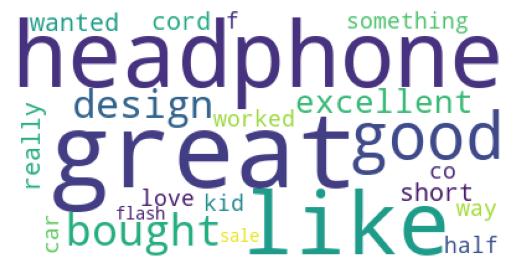

In [115]:
plt.axis('off')
plt.imshow(GoodWordcloud)
plt.show()

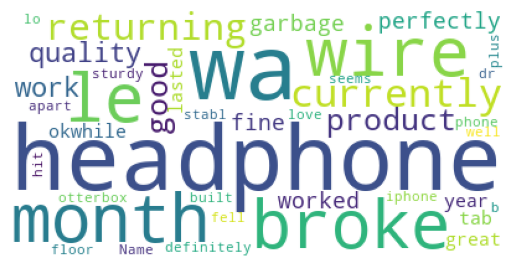

In [116]:
plt.axis('off')
plt.imshow(BadWordcloud)
plt.show()

In [117]:
# Plot a pie chart for Distribution of Ratings vs. the No. of Reviews.
import matplotlib.pyplot as plt

RatingsValueCount_df = PreProcesses_HeadPhones_df["overall"].value_counts()

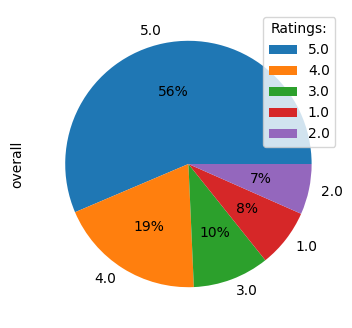

In [118]:
RatingsValueCount_df.plot(kind='pie', subplots=True, figsize=(4, 4),autopct='%1.0f%%')
plt.legend(title = "Ratings:")
plt.show()

In [119]:
# Report in which year the product got maximum reviews.
yearReviewMap = {}
for idx, headphone_review in PreProcesses_HeadPhones_df.iterrows():
    year = int(''.join(headphone_review["reviewTime"]).split(",")[1].strip())
    if year not in yearReviewMap:
        yearReviewMap[year] = 0
    yearReviewMap[year] = yearReviewMap[year] + 1

In [120]:
maxNoofReview = 0
YearHavingMaxReview = 0
for year in yearReviewMap:
    if yearReviewMap[year] > maxNoofReview:
        maxNoofReview = yearReviewMap[year]
        YearHavingMaxReview = year

In [121]:
YearHavingMaxReview

2016

In [122]:
# Which year has the highest number of Customers?
yearVsCustomers = {}
for idx, headphone_review in PreProcesses_HeadPhones_df.iterrows():
    year = int(''.join(headphone_review["reviewTime"]).split(",")[1].strip())
    reviewerId = ''.join(headphone_review["reviewerID"])
    if year not in yearVsCustomers:
        yearVsCustomers[year] = []
    if  reviewerId not in yearVsCustomers[year]:    
        yearVsCustomers[year].append(reviewerId)

In [123]:
yearMaxCustomer = 0
MaxCustomer = 0
for year in yearVsCustomers:
    if len(yearVsCustomers[year]) > MaxCustomer:
        MaxCustomer = len(yearVsCustomers[year])
        yearMaxCustomer = year

In [124]:
print(f"year having max customer is {yearMaxCustomer}")

year having max customer is 2016


In [125]:
PreProcesses_HeadPhones_df

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime
0,5.0,True,"02 22, 2015",A38RQFVQ1AKJQQ,4126895493,George Walker,great headphone its just the cord is too short,Five Stars,1424563200
1,5.0,True,"05 8, 2017",A299MRB9O6GWDE,4126895493,Carolyn B,really like these headphone wanted something f...,Officewear,1494201600
2,1.0,True,"11 5, 2016",A3ACFC6DQQLIQT,4126895493,MK,wire to headphone broke off in le than a month...,For the money they are fine. Just hope they ho...,1478304000
3,3.0,True,"09 24, 2016",A36BC0YFDBNB5X,4126895493,bigboy,very good,Three Stars,1474675200
4,1.0,True,"07 17, 2016",A212PQ0HQPNNWM,4126895493,Kelly Hales,currently returning this product because the s...,Currently returning this product because the s...,1468713600
...,...,...,...,...,...,...,...,...,...
389710,5.0,True,"09 8, 2016",A50A134UOQSQF,B01HJ8E11E,charles h evans,bought this on a flash sale and it excellent i...,"Good holder, simple and functional",1473292800
389711,4.0,True,"08 12, 2016",A2S2R3SUSFHJ61,B01HJ8E11E,Cheryl Showalters,this is excellent especially for the price,works great and the price is excellent. Holds...,1470960000
389712,4.0,True,"09 22, 2018",A3VA3VK4PO1JD,B01HJ8E11E,CD,i have only used these for 1 week at the time ...,They work...,1537574400
389713,3.0,True,"09 12, 2018",A11TVS6FKXS80H,B01HJ8E11E,Jay Salamon,the product work great but when it get down to...,30% charge shuts the device off,1536710400


In [23]:
PreProcesses_HeadPhones_df_subset = pd.DataFrame()

In [4]:
PreProcesses_HeadPhones_df_subset = PreProcesses_HeadPhones_df.sample(n=4000)

In [5]:
# 7
# citation:- https://spotintelligence.com/2022/12/20/bag-of-words-python/#:~:text=Scikit%2DLearn-,In%20Python%2C%20you%20can%20implement%20a%20bag%2Dof%2Dwords,CountVectorizer%20class%20in%20the%20sklearn.
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(max_features=10000)

In [6]:
reviews = []
for review in PreProcesses_HeadPhones_df_subset["reviewText"]:
    reviews.append(review)

In [7]:
reviews

['i love this case better than any ive ever had i drop my phone a lot and it ha kept it safe for a long time',
 'im a gadget geek and here is my review of this product it function a intended but there are some minor flaw of this productits cheaply made so expect the ff pros functions a intended perfect for yahoo messengerskype voips adjustible ear clip and mouth piece price cons since made of cheap material should be handled with care wire is so thin so expect problem in the connection in the future use wire in the plugin jack is very thin overall quality 25durability 15 price 45 function 45 i purchased this item but i would not recommend this gadget to anyone who is not careful in handling thing',
 'although the earbuds are fairly large the earbuds produce a great sound with high quality treble and bass the battery last a decent amount of time a well great for working out and running because of the bluetooth technology',
 'great product i use this a an in ear monitor at church and it 

In [8]:
vectorizer.fit(reviews)

CountVectorizer(max_features=10000)

In [ ]:
# type(headphone_review["reviewText"])

In [9]:
BAG_of_Words = vectorizer.transform(reviews)

In [10]:
print(BAG_of_Words.getnnz())

189027


In [11]:
TF = pd.DataFrame(BAG_of_Words.toarray(), columns=vectorizer.get_feature_names())

c:\Users\hp\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [12]:
TF

,0000,0000i,01,05242012,055mm,060215,062611,082116,082216,090416,...,zone,zoom,zte,zune,zut,zvox,zx100,zx110,zx2,zx300
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3996,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3997,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3998,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [13]:
#TF_idf
from sklearn.feature_extraction.text import TfidfTransformer

Transformer = TfidfTransformer()
TF_IDF_Vector = Transformer.fit_transform(BAG_of_Words)

In [14]:
TF_IDF_Vector

<4000x10000 sparse matrix of type '<class 'numpy.float64'>'
	with 189027 stored elements in Compressed Sparse Row format>

In [15]:
TF_IDF = pd.DataFrame(TF_IDF_Vector.toarray() ,columns=vectorizer.get_feature_names())

c:\Users\hp\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [16]:
TF_IDF

,0000,0000i,01,05242012,055mm,060215,062611,082116,082216,090416,...,zone,zoom,zte,zune,zut,zvox,zx100,zx110,zx2,zx300
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3997,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3998,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# 8
# The Rating Class is divided into three categories
# ● > 3 as Good
# ● =3 as Average
# ● <3 as Bad.

In [30]:
type(PreProcesses_HeadPhones_df.head(1)["overall"])

pandas.core.series.Series

In [17]:
for idx, headphone_review in PreProcesses_HeadPhones_df_subset.iterrows():
    rating = int(headphone_review["overall"])
    if  rating > 3:
        PreProcesses_HeadPhones_df_subset.at[idx, 'rating_class']  = "Good"
    elif rating == 3:
        PreProcesses_HeadPhones_df_subset.at[idx, 'rating_class']  = "Average"
    elif rating < 3:
        PreProcesses_HeadPhones_df_subset.at[idx, 'rating_class']  = "Bad"

In [37]:
PreProcesses_HeadPhones_df_subset

,overall,verified,reviewTime,reviewerID,asin,reviewerName,reviewText,summary,unixReviewTime,rating_class
140599,5.0,True,"09 27, 2016",A3HBF5WVSFUUDB,B00A7NC5Z8,A.B.,folded portapro headphone fit exactly into thi...,Folded PortaPro headphones fit exactly into th...,1474934400,Good
64462,5.0,True,"02 24, 2016",A1P383N549ZGS6,B002SOU2Y0,Allen K. Froehlich,excellent,Five Stars,1456272000,Good
181139,3.0,True,"08 25, 2014",A3MWICRPOPZD6W,B00EL0EIGC,DT,kind of cheap feeling serves it purpose i thin...,Serves its purpose,1408924800,Average
133299,4.0,True,"02 4, 2013",AC310CJFLN3ZA,B009923WIW,rcookenc,when i first got these i had a hard time getti...,Here's a secret you need to know,1359936000,Good
169822,3.0,False,"10 15, 2013",A25FJ8W6WCBFEC,B00DIOALYA,amazonian,i am another one who no matter which ear tip i...,Good product but a few problems,1381795200,Average
...,...,...,...,...,...,...,...,...,...,...
318575,5.0,True,"08 23, 2016",A3AQ279I3NTVEI,B011L1190G,Davers,replaced a cable that had dropped one of the c...,Fixed a bad connection I had with the previous...,1471910400,Good
312385,1.0,True,"07 13, 2015",A287XN065ABO9B,B0100XGCU8,David C. Stout,here i thought refurbished meant that plantron...,Another BAD Testimony,1436745600,Bad
211214,5.0,True,"09 22, 2017",A2Q32LF8XSA0LK,B00J80IMJ4,Ron P. Marinelli,works a expected,Good replacement.,1506038400,Good
362616,5.0,True,"10 6, 2017",A185KBEZUXZJSM,B01AOLSXJ4,Peter Diaz,great case for my headphone fits great and gre...,Five Stars,1507248000,Good


In [18]:
# 9. From the dataset, take the Review Text as input feature and Rating Class as target
# variable. Divide the data into Train and Test Data in the ratio of 75:25.
# Making dataset of TF_IDF as input feature vs rating class Target Label
dataset = TF_IDF.copy()

In [19]:
dataset['rating_class'] = PreProcesses_HeadPhones_df_subset['rating_class'].to_numpy()

In [40]:
dataset

,003,005bag,009,0100,011817,02,032717,060215,079mm,09,...,zooming,zs,zte,zune,zvox,zx100,zx100s,zx1the,zxr,rating_class
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Good
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Good
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Average
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Good
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Average
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Good
3996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Bad
3997,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Good
3998,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Good


In [20]:
dataset.iloc[:, :-1]

,0000,0000i,01,05242012,055mm,060215,062611,082116,082216,090416,...,zone,zoom,zte,zune,zut,zvox,zx100,zx110,zx2,zx300
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3997,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3998,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [21]:
dataset.to_pickle("ML_Dataset.pkl")

In [ ]:
dataset = pd.read_pickle("ML_Dataset.pkl")

In [22]:
from sklearn.model_selection import train_test_split 
X_train, X_test, y_train, y_test = train_test_split(dataset.iloc[:, :-1],dataset["rating_class"])

In [23]:
X_train.iloc[1]["the"]

0.06362349158082317

In [ ]:
# 10.Compare the performance of 5 Machine Learning based models on the basis of
# Precision, Recall, F-1 Score and Support for each of the 3 target classes distinctly.

In [24]:
from sklearn.linear_model import LogisticRegression

logisticRegressionModel = LogisticRegression()
logisticRegressionModel.fit(X_train,y_train)
prediction = logisticRegressionModel.predict(X_test)

In [25]:
from sklearn.metrics import classification_report
metricesReport = classification_report(y_test, prediction, output_dict=True)
metricesReport_df = pd.DataFrame(metricesReport).transpose()

print(f"Precision for Logistic regression is:- \n{metricesReport_df['precision']}")
print(f"Recall for Logistic regression is:- \n{metricesReport_df['recall']}")
print(f"f1-score for Logistic regression is:- \n{metricesReport_df['f1-score']}")
print(f"Support for Logistic regression is:- \n{metricesReport_df['support']}")

Precision for Logistic regression is:- 
Average         0.277778
Bad             0.836735
Good            0.830654
accuracy        0.821000
macro avg       0.648389
weighted avg    0.786139
Name: precision, dtype: float64
Recall for Logistic regression is:- 
Average         0.060976
Bad             0.303704
Good            0.989783
accuracy        0.821000
macro avg       0.451487
weighted avg    0.821000
Name: recall, dtype: float64
f1-score for Logistic regression is:- 
Average         0.100000
Bad             0.445652
Good            0.903263
accuracy        0.821000
macro avg       0.482972
weighted avg    0.775618
Name: f1-score, dtype: float64
Support for Logistic regression is:- 
Average           82.000
Bad              135.000
Good             783.000
accuracy           0.821
macro avg       1000.000
weighted avg    1000.000
Name: support, dtype: float64


In [39]:
from sklearn.svm import SVC

SupportVectorMachineModel = SVC()
SupportVectorMachineModel.fit(X_train,y_train)

SVC()

In [40]:
SVM_prediction = SupportVectorMachineModel.predict(X_test)

In [41]:
from sklearn.metrics import classification_report
SVM_metricesReport = classification_report(y_test, SVM_prediction, output_dict=True)
SVM_metricesReport_df = pd.DataFrame(SVM_metricesReport).transpose()

print(f"Precision for SVM is:- \n{SVM_metricesReport_df['precision']}")
print(f"Recall for SVM is:- \n{SVM_metricesReport_df['recall']}")
print(f"f1-score for SVM is:- \n{SVM_metricesReport_df['f1-score']}")
print(f"Support for SVM is:- \n{SVM_metricesReport_df['support']}")

Precision for SVM is:- 
Average         1.000000
Bad             0.840000
Good            0.801848
accuracy        0.803000
macro avg       0.880616
weighted avg    0.823247
Name: precision, dtype: float64
Recall for SVM is:- 
Average         0.012195
Bad             0.155556
Good            0.997446
accuracy        0.803000
macro avg       0.388399
weighted avg    0.803000
Name: recall, dtype: float64
f1-score for SVM is:- 
Average         0.024096
Bad             0.262500
Good            0.889015
accuracy        0.803000
macro avg       0.391871
weighted avg    0.733512
Name: f1-score, dtype: float64
Support for SVM is:- 
Average           82.000
Bad              135.000
Good             783.000
accuracy           0.803
macro avg       1000.000
weighted avg    1000.000
Name: support, dtype: float64


In [26]:
from sklearn.tree import DecisionTreeClassifier
DecisionTreeModel = DecisionTreeClassifier()

In [27]:
DecisionTreeModel.fit(X_train, y_train)

DecisionTreeClassifier()

In [28]:
DecisionTreePrediction = DecisionTreeModel.predict(X_test)

In [29]:
from sklearn.metrics import classification_report
DT_metricesReport = classification_report(y_test, DecisionTreePrediction, output_dict=True)
DT_metricesReport_df = pd.DataFrame(DT_metricesReport).transpose()

print(f"Precision for Decision Tree is:- \n{DT_metricesReport_df['precision']}")
print(f"Recall for Decision Tree is:- \n{DT_metricesReport_df['recall']}")
print(f"f1-score for Decision Tree is:- \n{DT_metricesReport_df['f1-score']}")
print(f"Support for Decision Tree is:- \n{DT_metricesReport_df['support']}")

Precision for Decision Tree is:- 
Average         0.134146
Bad             0.397163
Good            0.850708
accuracy        0.728000
macro avg       0.460672
weighted avg    0.730721
Name: precision, dtype: float64
Recall for Decision Tree is:- 
Average         0.134146
Bad             0.414815
Good            0.844189
accuracy        0.728000
macro avg       0.464383
weighted avg    0.728000
Name: recall, dtype: float64
f1-score for Decision Tree is:- 
Average         0.134146
Bad             0.405797
Good            0.847436
accuracy        0.728000
macro avg       0.462460
weighted avg    0.729325
Name: f1-score, dtype: float64
Support for Decision Tree is:- 
Average           82.000
Bad              135.000
Good             783.000
accuracy           0.728
macro avg       1000.000
weighted avg    1000.000
Name: support, dtype: float64


In [30]:
from sklearn.neighbors import KNeighborsClassifier
KNN_Model = KNeighborsClassifier()

In [31]:
KNN_Model.fit(X_train, y_train)

KNeighborsClassifier()

In [32]:
KNN_ModelPrediction = KNN_Model.predict(X_test)

In [34]:
from sklearn.metrics import classification_report
KNN_metricesReport = classification_report(y_test, KNN_ModelPrediction, output_dict=True)
KNN_metricesReport_df = pd.DataFrame(KNN_metricesReport).transpose()

print(f"Precision for KNN is:- \n{KNN_metricesReport_df['precision']}")
print(f"Recall for KNN is:- \n{KNN_metricesReport_df['recall']}")
print(f"f1-score for KNN is:- \n{KNN_metricesReport_df['f1-score']}")
print(f"Support for KNN is:- \n{KNN_metricesReport_df['support']}")

Precision for KNN is:- 
Average         0.000000
Bad             1.000000
Good            0.783567
accuracy        0.783000
macro avg       0.594522
weighted avg    0.748533
Name: precision, dtype: float64
Recall for KNN is:- 
Average         0.000000
Bad             0.007407
Good            0.998723
accuracy        0.783000
macro avg       0.335377
weighted avg    0.783000
Name: recall, dtype: float64
f1-score for KNN is:- 
Average         0.000000
Bad             0.014706
Good            0.878158
accuracy        0.783000
macro avg       0.297621
weighted avg    0.689583
Name: f1-score, dtype: float64
Support for KNN is:- 
Average           82.000
Bad              135.000
Good             783.000
accuracy           0.783
macro avg       1000.000
weighted avg    1000.000
Name: support, dtype: float64


In [35]:
from sklearn.ensemble import RandomForestClassifier
RandomForestModel = RandomForestClassifier()

In [36]:
RandomForestModel.fit(X_train, y_train)

RandomForestClassifier()

In [37]:
RandomForestPrediction = RandomForestModel.predict(X_test)

In [38]:
from sklearn.metrics import classification_report
RF_metricesReport = classification_report(y_test, RandomForestPrediction, output_dict=True)
RF_metricesReport_df = pd.DataFrame(RF_metricesReport).transpose()

print(f"Precision for random forest is:- \n{RF_metricesReport_df['precision']}")
print(f"Recall for random forest is:- \n{RF_metricesReport_df['recall']}")
print(f"f1-score for random forest is:- \n{RF_metricesReport_df['f1-score']}")
print(f"Support for random forest is:- \n{RF_metricesReport_df['support']}")

Precision for random forest is:- 
Average         0.000000
Bad             0.800000
Good            0.799589
accuracy        0.798000
macro avg       0.533196
weighted avg    0.734078
Name: precision, dtype: float64
Recall for random forest is:- 
Average         0.000000
Bad             0.148148
Good            0.993614
accuracy        0.798000
macro avg       0.380587
weighted avg    0.798000
Name: recall, dtype: float64
f1-score for random forest is:- 
Average         0.000000
Bad             0.250000
Good            0.886105
accuracy        0.798000
macro avg       0.378702
weighted avg    0.727570
Name: f1-score, dtype: float64
Support for random forest is:- 
Average           82.000
Bad              135.000
Good             783.000
accuracy           0.798
macro avg       1000.000
weighted avg    1000.000
Name: support, dtype: float64


In [ ]:
# 11. Collaborative Filtering :
#   a) Create a user-item rating matrix
#   b) Normalize the ratings, by using min-max scaling on user’s reviews
#   c) Create a user-user recommender system - i.e,
#   i) Find the top N similar users, by using cosine similarity. N = 10, 20, 30,
#   40, 50
#   ii) Use K-folds validation. K = 5. Explanation: Create 5 subsets, and take 1
#   of them as the validation set. Take the rest 4 to be the training set.
#   iii) Use the training set to predict the missing values, and use the validation
#   set to calculate the error. (Error = |actual_rating - predicted_rating|)
#   iv) Report the MAE (Mean Absolute Error) for taking K = 10, 20, 30, 40,
#   50 similar users.
#   d) Create an item-item recommender system. Use the same steps as above.
#   e) Plot separate graphs for each of the two recommender systems, plotting
#   MAE against K

In [26]:
# citation:- https://www.javatpoint.com/k-fold-cross-validation-in-sklearn
from sklearn.model_selection import KFold   
k_fold = KFold(n_splits = 5)  

In [49]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

def customCosineSimilarity(vector1,vector2):
    v1 = vector1
    v2 = vector2
    if(len(v1) != len(v2)):
        return None
    
    product = np.dot(v1,v2)

    square_sum_vector_1 = 0
    for val in v1:
        square_sum_vector_1 += (val**2)

    square_sum_vector_2 = 0
    for val in v2:
        square_sum_vector_2 += (val**2)

    product_of_sqrt_square_sums_roots = np.sqrt(square_sum_vector_1) * np.sqrt(square_sum_vector_2)

    result = product/product_of_sqrt_square_sums_roots
    return result

In [62]:
PreProcesses_HeadPhones_df_subset_11 = PreProcesses_HeadPhones_df.sample(n = 100)

In [63]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
# citattion:- https://stackoverflow.com/a/55129763

K_10 = []
K_20 = []
K_30 = []
K_40 = []
K_50 = []

scaler = MinMaxScaler()
user_item_matrix_Validation = PreProcesses_HeadPhones_df_subset_11.pivot_table(index='reviewerID', columns='asin', values='overall', aggfunc='first') 
user_item_matrix_Validation_Inverse = user_item_matrix_Validation.T
user_item_matrix_Validation_Inverse_scaled = pd.DataFrame(scaler.fit_transform(user_item_matrix_Validation_Inverse.values), columns=user_item_matrix_Validation_Inverse.columns, index=user_item_matrix_Validation_Inverse.index)
user_item_matrix_Validation_normalized = user_item_matrix_Validation_Inverse_scaled.T
user_item_matrix_Validation_normalized.fillna(-1, inplace=True)


i = 1
for train_idx, test_idx in k_fold.split(PreProcesses_HeadPhones_df_subset_11):  
    print(i)
    i += 1
    X_F_train, X_F_test = PreProcesses_HeadPhones_df_subset_11.iloc[train_idx,:],PreProcesses_HeadPhones_df_subset_11.iloc[test_idx,:] 

    print("X_F_train", X_F_train)

    print("X_F_test", X_F_test)

    user_item_matrix = X_F_train.pivot_table(index='reviewerID', columns='asin', values='overall', aggfunc='first')
    scaler = MinMaxScaler()
    user_item_matrix_Inverse = user_item_matrix.T
    user_item_matrix_Inverse_scaled = pd.DataFrame(scaler.fit_transform(user_item_matrix_Inverse.values), columns=user_item_matrix_Inverse.columns, index=user_item_matrix_Inverse.index)
    user_item_matrix_normalized = user_item_matrix_Inverse_scaled.T
    user_item_matrix_normalized.fillna(-1, inplace=True)


    UservsUser_similairity_matrix = pd.DataFrame(index=user_item_matrix_normalized.index, columns=user_item_matrix_normalized.index)

    for idx1, row1 in user_item_matrix_normalized.iterrows():
        for idx2, row2 in user_item_matrix_normalized.iterrows():
            cosine_similarity_withall_values = cosine_similarity(row1.values.reshape(1, -1), row2.values.reshape(1, -1))
            print(cosine_similarity_withall_values)
            UservsUser_similairity_matrix.at[idx1, idx2] = cosine_similarity_withall_values[0][0]
    
    
    UserVsUser_dict_10 = {}
    for idx, row in UservsUser_similairity_matrix.iterrows():
        top_11_users = row.sort_values(ascending=False).head(11).index.tolist()
        print(top_11_users)
        UserVsUser_dict_10[idx] = top_11_users
        print(idx, UserVsUser_dict_10[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        UserVsUser_dict_10[idx].remove(idx)

    UserVsUser_dict_20 = {}
    for idx, row in UservsUser_similairity_matrix.iterrows():
        top_21_users = row.sort_values(ascending=False).head(21).index.tolist()
        print(top_21_users)
        UserVsUser_dict_20[idx] = top_21_users
        print(idx, UserVsUser_dict_20[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        UserVsUser_dict_20[idx].remove(idx)

    # print("UserVsUser_dict_20")
    # print(UserVsUser_dict_20)

    UserVsUser_dict_30 = {}
    for idx, row in UservsUser_similairity_matrix.iterrows():
        top_31_users = row.sort_values(ascending=False).head(31).index.tolist()
        print(top_31_users)
        UserVsUser_dict_30[idx] = top_31_users
        print(idx, UserVsUser_dict_30[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        UserVsUser_dict_30[idx].remove(idx)

    # print("UserVsUser_dict_30")
    # print(UserVsUser_dict_30)


    UserVsUser_dict_40 = {}
    for idx, row in UservsUser_similairity_matrix.iterrows():
        top_41_users = row.sort_values(ascending=False).head(41).index.tolist()
        print(top_41_users)
        UserVsUser_dict_40[idx] = top_41_users
        print(idx, UserVsUser_dict_40[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        UserVsUser_dict_40[idx].remove(idx)

    # print("UserVsUser_dict_40")
    # print(UserVsUser_dict_40)

    UserVsUser_dict_50 = {}
    for idx, row in UservsUser_similairity_matrix.iterrows():
        top_51_users = row.sort_values(ascending=False).head(51).index.tolist()
        print(top_51_users)
        UserVsUser_dict_50[idx] = top_51_users
        print(idx, UserVsUser_dict_50[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        UserVsUser_dict_50[idx].remove(idx)

    # print("UserVsUser_dict_50")
    # print(UserVsUser_dict_50)

    
    print("UservsUser_similairity_matrix",UservsUser_similairity_matrix)
    user_item_matrix_normalized_10 = user_item_matrix_normalized.copy()
    

    # mae = mean_absolute_error(user_item_matrix_Validation_normalized.iloc[0].values, user_item_matrix_normalized_10.iloc[0].values)
    print(user_item_matrix_Validation_normalized.iloc[0].values, user_item_matrix_normalized_10.iloc[0].values)

    print("user_item_matrix_normalized", user_item_matrix_normalized)
    print("user_item_matrix_normalized_10", user_item_matrix_normalized_10)
    print("user_item_matrix_Validation", user_item_matrix_Validation_normalized)


    

    for userId in UserVsUser_dict_10:
        similar_Users = UserVsUser_dict_10[userId]
        predicted_values = user_item_matrix_normalized_10.loc[similar_Users].mean(axis=0)
        row = user_item_matrix_normalized_10.loc[userId]
        for column_name, column_data in row.iteritems():
            user_item_matrix_normalized_10[column_name] = predicted_values[column_name]
     

    
    
    mae_list_10 = []
    for idx, row in user_item_matrix_normalized_10.iterrows():
        print("I am outside")
        print(user_item_matrix_Validation.index)
        print(idx)
        if idx in user_item_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in user_item_matrix_Validation.columns:
                    mae += abs(user_item_matrix_Validation_normalized.loc[idx,column_name] - user_item_matrix_normalized_10.loc[idx,column_name])
           
            mae = mae /  user_item_matrix_normalized_10.shape[1]
            mae_list_10.append(mae)

    print(mae_list_10)
    if len(mae_list_10) > 0:
        mae_10 = sum(mae_list_10) / len(mae_list_10)

        K_10.append(mae_10)
    
    
    user_item_matrix_normalized_20 = user_item_matrix_normalized.copy()
    for userId in UserVsUser_dict_20:
        similar_Users = UserVsUser_dict_20[userId]
        predicted_values = user_item_matrix_normalized_20.loc[similar_Users].mean(axis=0)
        row = user_item_matrix_normalized_20.loc[userId]
        for column_name, column_data in row.iteritems():
            user_item_matrix_normalized_20[column_name] = predicted_values[column_name]
     

    
    
    mae_list_20 = []
    for idx, row in user_item_matrix_normalized_20.iterrows():
        print("I am outside")
        print(user_item_matrix_Validation.index)
        print(idx)
        if idx in user_item_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in user_item_matrix_Validation.columns:
                    mae += abs(user_item_matrix_Validation_normalized.loc[idx,column_name] - user_item_matrix_normalized_20.loc[idx,column_name])
           
            mae = mae /  user_item_matrix_normalized_20.shape[1]
            mae_list_20.append(mae)

    print(mae_list_20)
    if len(mae_list_20) > 0:
        mae_20 = sum(mae_list_20) / len(mae_list_20)

        K_20.append(mae_20)




    user_item_matrix_normalized_30 = user_item_matrix_normalized.copy()
    for userId in UserVsUser_dict_30:
        similar_Users = UserVsUser_dict_30[userId]
        predicted_values = user_item_matrix_normalized_30.loc[similar_Users].mean(axis=0)
        row = user_item_matrix_normalized_30.loc[userId]
        for column_name, column_data in row.iteritems():
            user_item_matrix_normalized_30[column_name] = predicted_values[column_name]
     

    
    
    mae_list_30 = []
    for idx, row in user_item_matrix_normalized_30.iterrows():
        print("I am outside")
        print(user_item_matrix_Validation.index)
        print(idx)
        if idx in user_item_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in user_item_matrix_Validation.columns:
                    mae += abs(user_item_matrix_Validation_normalized.loc[idx,column_name] - user_item_matrix_normalized_30.loc[idx,column_name])
           
            mae = mae /  user_item_matrix_normalized_30.shape[1]
            mae_list_30.append(mae)

    print(mae_list_30)
    if len(mae_list_30) > 0:
        mae_30 = sum(mae_list_30) / len(mae_list_30)

        K_30.append(mae_30)


    user_item_matrix_normalized_40 = user_item_matrix_normalized.copy()
    for userId in UserVsUser_dict_40:
        similar_Users = UserVsUser_dict_40[userId]
        predicted_values = user_item_matrix_normalized_40.loc[similar_Users].mean(axis=0)
        row = user_item_matrix_normalized_40.loc[userId]
        for column_name, column_data in row.iteritems():
            user_item_matrix_normalized_40[column_name] = predicted_values[column_name]
     

    
    
    mae_list_40 = []
    for idx, row in user_item_matrix_normalized_40.iterrows():
        print("I am outside")
        print(user_item_matrix_Validation.index)
        print(idx)
        if idx in user_item_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in user_item_matrix_Validation.columns:
                    mae += abs(user_item_matrix_Validation_normalized.loc[idx,column_name] - user_item_matrix_normalized_40.loc[idx,column_name])
           
            mae = mae /  user_item_matrix_normalized_40.shape[1]
            mae_list_40.append(mae)

    print(mae_list_40)
    if len(mae_list_40) > 0:
        mae_40 = sum(mae_list_40) / len(mae_list_40)

        K_40.append(mae_40)



    user_item_matrix_normalized_50 = user_item_matrix_normalized.copy()
    for userId in UserVsUser_dict_50:
        similar_Users = UserVsUser_dict_50[userId]
        predicted_values = user_item_matrix_normalized_50.loc[similar_Users].mean(axis=0)
        row = user_item_matrix_normalized_50.loc[userId]
        for column_name, column_data in row.iteritems():
            user_item_matrix_normalized_50[column_name] = predicted_values[column_name]
     

    
    
    mae_list_50 = []
    for idx, row in user_item_matrix_normalized_50.iterrows():
        print("I am outside")
        print(user_item_matrix_Validation.index)
        print(idx)
        if idx in user_item_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in user_item_matrix_Validation.columns:
                    mae += abs(user_item_matrix_Validation_normalized.loc[idx,column_name] - user_item_matrix_normalized_50.loc[idx,column_name])
           
            mae = mae /  user_item_matrix_normalized_50.shape[1]
            mae_list_50.append(mae)

    print(mae_list_50)
    if len(mae_list_50) > 0:
        mae_50 = sum(mae_list_50) / len(mae_list_50)

        K_50.append(mae_50)


        

1
X_F_train         overall  verified   reviewTime      reviewerID        asin  \
275176      3.0      True  10 19, 2015  A2NZWTR1G3T6NH  B00S5CPERY   
30845       5.0      True  05 17, 2013   AMOMITKUQYLEH  B0007XJSQC   
283414      5.0      True  04 21, 2015   ARGE0KE44H7ZJ  B00TCURUSE   
161773      4.0      True  01 22, 2016  A1DUG2ZGQF91O5  B00CBPJLFW   
296384      5.0      True  02 19, 2013  A37B3N5SALRDAW  B00WSLZFTK   
...         ...       ...          ...             ...         ...   
140838      3.0      True   04 7, 2015  A3L0CJK14YNY6M  B00A8S5KIG   
343338      3.0      True  02 22, 2016  A2ENVZLRBGCNHZ  B016XYGFHI   
107048      5.0     False  02 16, 2014  A126OTEVY1QMGS  B006QR8W6K   
12915       5.0     False  07 13, 2014  A3S0BR9AJ8KJ0L  B00007E7C8   
297851      4.0      True  07 27, 2010  A30ODIBCNK0PTX  B00WUCHEH8   

            reviewerName                                         reviewText  \
275176     ZetraDraconic  i bought this case for my monster dna onea

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:124: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:157: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:192: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:225: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\958861448.py:259: FutureWarning: iteritems is deprecated and will be removed in a future 

I am outside
Index(['A126OTEVY1QMGS', 'A13ZM5LP84GBOB', 'A1486KL0IOM7VM', 'A14STIFH1ASIYU',
       'A1512WFKVS8VF3', 'A1BKJ1WQAAAD8Z', 'A1DUG2ZGQF91O5', 'A1FI55TU5U9TP1',
       'A1H4KL1W5QPGJV', 'A1I3PW0PWC4U9U', 'A1I9MLOEREQ78I', 'A1JNBERVD0ZVMJ',
       'A1JPDZ7YL5ZYK4', 'A1KPMQCB9N7XQX', 'A1LV4L1S50QEXM', 'A1MQABQ8RUT4UK',
       'A1N6T9A7D8ZPGV', 'A1OPR5AJIOX0Y3', 'A1OTBUCLTFKLQU', 'A1R0JMNRV7HVQM',
       'A1T3T9T5BPQPY2', 'A1WH6164O19W53', 'A1XJOSJN6FHFO0', 'A1ZQSDTSMTB9WZ',
       'A20W430MYV3LRJ', 'A224VIWJZX23D6', 'A22RXA79FBY6EO', 'A22YIN071NTZPK',
       'A24ZV2YAY5ILHB', 'A2B6BHVOI0NYWB', 'A2BAPDGCCVC4S6', 'A2BX57YX127C83',
       'A2CE19GY5ZU564', 'A2ENVZLRBGCNHZ', 'A2FP9P6C1I8W6M', 'A2H0AZDHA83239',
       'A2HLQJ5CQZKPLA', 'A2JIX0MMHG64CI', 'A2JZIIMSM4D6YR', 'A2KT99PDQD2554',
       'A2LD5W19TDOC4Q', 'A2LRC45QOOLQBD', 'A2LWBIGSHKTI1L', 'A2N2F6ZMUV21MA',
       'A2NZWTR1G3T6NH', 'A2PJ0XLO1WHU7C', 'A2PZXXPGLXXKZU', 'A2TSJ11N0EVYH9',
       'A2VFU1K561R81R', 'A2X0RB3JKV4E7

In [64]:
K_10

[0.025584415584415578,
 0.025320512820512786,
 0.02595394736842107,
 0.025649350649350644,
 0.025888157894736863]

In [65]:
K_20

[0.02561688311688313,
 0.025288461538461628,
 0.025953947368421132,
 0.02561688311688314,
 0.02593750000000008]

0.025679276863487387 0.025682735028129823 0.02569035423640741 0.02568920826980034 0.02569246805825754


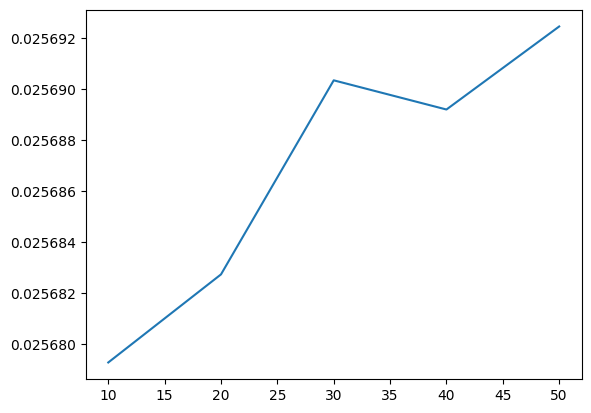

In [66]:
import matplotlib.pyplot as plt

X_axis = [10,20,30,40,50]

K_10_mean =  sum(K_10) / len(K_10)
K_20_mean =  sum(K_20) / len(K_20)
K_30_mean =  sum(K_30) / len(K_30)
K_40_mean =  sum(K_40) / len(K_40)
K_50_mean =  sum(K_50) / len(K_50)


print(K_10_mean,K_20_mean,K_30_mean,K_40_mean,K_50_mean)
Y_axis = [K_10_mean,K_20_mean,K_30_mean,K_40_mean,K_50_mean]

plt.plot(X_axis,Y_axis)
plt.show()

In [55]:
K_10_mean

0.05319258732416626

In [69]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error
# citattion:- https://stackoverflow.com/a/55129763

K_10 = []
K_20 = []
K_30 = []
K_40 = []
K_50 = []

scaler = MinMaxScaler()
item_user_matrix_Validation = PreProcesses_HeadPhones_df_subset_11.pivot_table(index='asin', columns='reviewerID', values='overall', aggfunc='first') 
item_user_matrix_Validation_Inverse = item_user_matrix_Validation.T
item_user_matrix_Validation_Inverse_scaled = pd.DataFrame(scaler.fit_transform(item_user_matrix_Validation_Inverse.values), columns=item_user_matrix_Validation_Inverse.columns, index=item_user_matrix_Validation_Inverse.index)
item_user_matrix_Validation_normalized = item_user_matrix_Validation_Inverse_scaled.T
item_user_matrix_Validation_normalized.fillna(-1, inplace=True)


i = 1
for train_idx, test_idx in k_fold.split(PreProcesses_HeadPhones_df_subset_11):  
    print(i)
    i += 1
    X_F_train, X_F_test = PreProcesses_HeadPhones_df_subset_11.iloc[train_idx,:],PreProcesses_HeadPhones_df_subset_11.iloc[test_idx,:] 

    print("X_F_train", X_F_train)

    print("X_F_test", X_F_test)

    item_user_matrix = X_F_train.pivot_table(index='asin', columns='reviewerID', values='overall', aggfunc='first')
    scaler = MinMaxScaler()
    item_user_matrix_Inverse = item_user_matrix.T
    item_user_matrix_Inverse_scaled = pd.DataFrame(scaler.fit_transform(item_user_matrix_Inverse.values), columns=item_user_matrix_Inverse.columns, index=item_user_matrix_Inverse.index)
    item_user_matrix_normalized = item_user_matrix_Inverse_scaled.T
    item_user_matrix_normalized.fillna(-1, inplace=True)


    ItemVsItem_similairity_matrix = pd.DataFrame(index=item_user_matrix_normalized.index, columns=item_user_matrix_normalized.index)

    for idx1, row1 in item_user_matrix_normalized.iterrows():
        for idx2, row2 in item_user_matrix_normalized.iterrows():
            cosine_similarity_withall_values = cosine_similarity(row1.values.reshape(1, -1), row2.values.reshape(1, -1))
            print(cosine_similarity_withall_values)
            ItemVsItem_similairity_matrix.at[idx1, idx2] = cosine_similarity_withall_values[0][0]
    
    
    ItemVsItem_dict_10 = {}
    for idx, row in ItemVsItem_similairity_matrix.iterrows():
        top_11_items = row.sort_values(ascending=False).head(11).index.tolist()
        print(top_11_items)
        ItemVsItem_dict_10[idx] = top_11_items
        print(idx, ItemVsItem_dict_10[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        ItemVsItem_dict_10[idx].remove(idx)

    ItemVsItem_dict_20 = {}
    for idx, row in ItemVsItem_similairity_matrix.iterrows():
        top_21_items = row.sort_values(ascending=False).head(21).index.tolist()
        print(top_21_items)
        ItemVsItem_dict_20[idx] = top_21_items
        print(idx, ItemVsItem_dict_20[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        ItemVsItem_dict_20[idx].remove(idx)

    # print("UserVsUser_dict_20")
    # print(UserVsUser_dict_20)

    ItemVsItem_dict_30 = {}
    for idx, row in ItemVsItem_similairity_matrix.iterrows():
        top_31_items = row.sort_values(ascending=False).head(31).index.tolist()
        print(top_31_items)
        ItemVsItem_dict_30[idx] = top_31_items
        print(idx, ItemVsItem_dict_30[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        ItemVsItem_dict_30[idx].remove(idx)

    # print("UserVsUser_dict_30")
    # print(UserVsUser_dict_30)


    ItemVsItem_dict_40 = {}
    for idx, row in ItemVsItem_similairity_matrix.iterrows():
        top_41_items = row.sort_values(ascending=False).head(41).index.tolist()
        print(top_41_items)
        ItemVsItem_dict_40[idx] = top_41_items
        print(idx, ItemVsItem_dict_40[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        ItemVsItem_dict_40[idx].remove(idx)

    # print("UserVsUser_dict_40")
    # print(UserVsUser_dict_40)

    ItemVsItem_dict_50 = {}
    for idx, row in ItemVsItem_similairity_matrix.iterrows():
        top_51_items = row.sort_values(ascending=False).head(51).index.tolist()
        print(top_51_items)
        ItemVsItem_dict_50[idx] = top_51_items
        print(idx, ItemVsItem_dict_50[idx])
        # print(idx,UservsUser_similairity_matrix.loc[row] )
        ItemVsItem_dict_50[idx].remove(idx)

    # print("UserVsUser_dict_50")
    # print(UserVsUser_dict_50)

    
    print("UservsUser_similairity_matrix",ItemVsItem_similairity_matrix)
    item_user_matrix_normalized_10 = item_user_matrix_normalized.copy()
    

    # mae = mean_absolute_error(user_item_matrix_Validation_normalized.iloc[0].values, user_item_matrix_normalized_10.iloc[0].values)
    print(item_user_matrix_Validation_normalized.iloc[0].values, item_user_matrix_normalized_10.iloc[0].values)

    print("user_item_matrix_normalized", item_user_matrix_normalized)
    print("user_item_matrix_normalized_10", item_user_matrix_normalized_10)
    print("user_item_matrix_Validation", item_user_matrix_Validation_normalized)


    
    for itemId in ItemVsItem_dict_10:
        similar_Items = ItemVsItem_dict_10[itemId]
        predicted_values = item_user_matrix_normalized_10.loc[similar_Items].mean(axis=0)
        row = item_user_matrix_normalized_10.loc[itemId]
        for column_name, column_data in row.iteritems():
            item_user_matrix_normalized_10[column_name] = predicted_values[column_name]
     

    
    
    mae_list_10 = []
    for idx, row in item_user_matrix_normalized_10.iterrows():
        print("I am outside")
        print(item_user_matrix_Validation.index)
        print(idx)
        if idx in item_user_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in item_user_matrix_Validation.columns:
                    mae += abs(item_user_matrix_Validation_normalized.loc[idx,column_name] - item_user_matrix_normalized_10.loc[idx,column_name])
           
            mae = mae /  item_user_matrix_normalized_10.shape[1]
            mae_list_10.append(mae)

    print(mae_list_10)
    if len(mae_list_10) > 0:
        mae_10 = sum(mae_list_10) / len(mae_list_10)

        K_10.append(mae_10)
    
    


    item_user_matrix_normalized_20 = item_user_matrix_normalized.copy()
    for itemId in ItemVsItem_dict_20:
        similar_Items = ItemVsItem_dict_20[itemId]
        predicted_values = item_user_matrix_normalized_20.loc[similar_Items].mean(axis=0)
        row = item_user_matrix_normalized_20.loc[itemId]
        for column_name, column_data in row.iteritems():
            item_user_matrix_normalized_20[column_name] = predicted_values[column_name]
     

    
    
    mae_list_20 = []
    for idx, row in item_user_matrix_normalized_20.iterrows():
        print("I am outside")
        print(item_user_matrix_Validation.index)
        print(idx)
        if idx in item_user_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in item_user_matrix_Validation.columns:
                    mae += abs(item_user_matrix_Validation_normalized.loc[idx,column_name] - item_user_matrix_normalized_20.loc[idx,column_name])
           
            mae = mae /  item_user_matrix_normalized_20.shape[1]
            mae_list_20.append(mae)

    print(mae_list_20)
    if len(mae_list_20) > 0:
        mae_20 = sum(mae_list_20) / len(mae_list_20)

        K_20.append(mae_20)



    item_user_matrix_normalized_30 = item_user_matrix_normalized.copy()
    for itemId in ItemVsItem_dict_30:
        similar_Items = ItemVsItem_dict_30[itemId]
        predicted_values = item_user_matrix_normalized_30.loc[similar_Items].mean(axis=0)
        row = item_user_matrix_normalized_30.loc[itemId]
        for column_name, column_data in row.iteritems():
            item_user_matrix_normalized_30[column_name] = predicted_values[column_name]
     

    
    
    mae_list_30 = []
    for idx, row in item_user_matrix_normalized_30.iterrows():
        print("I am outside")
        print(item_user_matrix_Validation.index)
        print(idx)
        if idx in item_user_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in item_user_matrix_Validation.columns:
                    mae += abs(item_user_matrix_Validation_normalized.loc[idx,column_name] - item_user_matrix_normalized_30.loc[idx,column_name])
           
            mae = mae /  item_user_matrix_normalized_30.shape[1]
            mae_list_30.append(mae)

    print(mae_list_30)
    if len(mae_list_30) > 0:
        mae_30 = sum(mae_list_30) / len(mae_list_30)

        K_30.append(mae_30)



    item_user_matrix_normalized_40 = item_user_matrix_normalized.copy()
    for itemId in ItemVsItem_dict_40:
        similar_Items = ItemVsItem_dict_40[itemId]
        predicted_values = item_user_matrix_normalized_40.loc[similar_Items].mean(axis=0)
        row = item_user_matrix_normalized_40.loc[itemId]
        for column_name, column_data in row.iteritems():
            item_user_matrix_normalized_40[column_name] = predicted_values[column_name]
     

    
    
    mae_list_40 = []
    for idx, row in item_user_matrix_normalized_40.iterrows():
        print("I am outside")
        print(item_user_matrix_Validation.index)
        print(idx)
        if idx in item_user_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in item_user_matrix_Validation.columns:
                    mae += abs(item_user_matrix_Validation_normalized.loc[idx,column_name] - item_user_matrix_normalized_40.loc[idx,column_name])
           
            mae = mae /  item_user_matrix_normalized_40.shape[1]
            mae_list_40.append(mae)

    print(mae_list_40)
    if len(mae_list_40) > 0:
        mae_40 = sum(mae_list_40) / len(mae_list_40)

        K_40.append(mae_40)



    item_user_matrix_normalized_50 = item_user_matrix_normalized.copy()
    for itemId in ItemVsItem_dict_50:
        similar_Items = ItemVsItem_dict_50[itemId]
        predicted_values = item_user_matrix_normalized_50.loc[similar_Items].mean(axis=0)
        row = item_user_matrix_normalized_50.loc[itemId]
        for column_name, column_data in row.iteritems():
            item_user_matrix_normalized_50[column_name] = predicted_values[column_name]
     

    
    
    mae_list_50 = []
    for idx, row in item_user_matrix_normalized_50.iterrows():
        print("I am outside")
        print(item_user_matrix_Validation.index)
        print(idx)
        if idx in item_user_matrix_Validation_normalized.index:
            print("I am inside")
            mae = 0
            for column_name, column_data in row.iteritems():
                if column_name in item_user_matrix_Validation.columns:
                    mae += abs(item_user_matrix_Validation_normalized.loc[idx,column_name] - item_user_matrix_normalized_50.loc[idx,column_name])
           
            mae = mae /  item_user_matrix_normalized_50.shape[1]
            mae_list_50.append(mae)

    print(mae_list_50)
    if len(mae_list_50) > 0:
        mae_50 = sum(mae_list_50) / len(mae_list_50)

        K_50.append(mae_50)


        

1
X_F_train         overall  verified   reviewTime      reviewerID        asin  \
275176      3.0      True  10 19, 2015  A2NZWTR1G3T6NH  B00S5CPERY   
30845       5.0      True  05 17, 2013   AMOMITKUQYLEH  B0007XJSQC   
283414      5.0      True  04 21, 2015   ARGE0KE44H7ZJ  B00TCURUSE   
161773      4.0      True  01 22, 2016  A1DUG2ZGQF91O5  B00CBPJLFW   
296384      5.0      True  02 19, 2013  A37B3N5SALRDAW  B00WSLZFTK   
...         ...       ...          ...             ...         ...   
140838      3.0      True   04 7, 2015  A3L0CJK14YNY6M  B00A8S5KIG   
343338      3.0      True  02 22, 2016  A2ENVZLRBGCNHZ  B016XYGFHI   
107048      5.0     False  02 16, 2014  A126OTEVY1QMGS  B006QR8W6K   
12915       5.0     False  07 13, 2014  A3S0BR9AJ8KJ0L  B00007E7C8   
297851      4.0      True  07 27, 2010  A30ODIBCNK0PTX  B00WUCHEH8   

            reviewerName                                         reviewText  \
275176     ZetraDraconic  i bought this case for my monster dna onea

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:172: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:206: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:274: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():


[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[1.]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98091162]]
[[0.98734177]]
[[0.98734177]]
[[0.98091162]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98091162]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0.98734177]]
[[0

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:240: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:123: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:158: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:192: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:226: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column_name, column_data in row.iteritems():
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\2573231146.py:260: FutureWarning: iteritems is deprecated and will be removed in a fu

I am outside
Index(['B00000JBHP', 'B00001P4ZH', 'B00001W0DI', 'B00001WRSJ', 'B00004Z5D1',
       'B00005N9D3', 'B00007E7C8', 'B0002CZHN6', 'B0007NIOK8', 'B0007NWL70',
       'B0007QN18U', 'B0007XJSQC', 'B000CBB4N4', 'B000E6G9RI', 'B000EH0NLK',
       'B000NV0SG2', 'B000PQLJ86', 'B0015AHRFK', 'B001DFX2OC', 'B001ODDBSU',
       'B001UO651S', 'B0035JKJ2W', 'B003CJTR8C', 'B003CJTR8M', 'B003S3DEUY',
       'B004COAO38', 'B004WODP20', 'B004ZIALYS', 'B005LKB0IU', 'B006QR8W6K',
       'B0074EUKDM', 'B007BTULVG', 'B007DL79FS', 'B007G54QX4', 'B008EPW1MI',
       'B009QV15DU', 'B00A8S5KIG', 'B00AFGP5MM', 'B00AVLOHJ8', 'B00AWIPITS',
       'B00BLG5CSC', 'B00CBPJLFW', 'B00CKIFPQY', 'B00CLFWLHC', 'B00DA7P0R8',
       'B00DIOAM4Y', 'B00DQOG1UA', 'B00F5NB7MW', 'B00F6SQ1D6', 'B00JE445S6',
       'B00K35MU0K', 'B00KJLMBQQ', 'B00KYGP0BO', 'B00LJT2EPK', 'B00LM6BNP2',
       'B00LPR9O9K', 'B00M2S2MPO', 'B00M6XTUPU', 'B00MMOT98G', 'B00NBEWB4U',
       'B00QTGRO3U', 'B00R0DCSSM', 'B00R62PHOO', 'B00S5CPERY', 

In [70]:
K_10

[0.02532467532467529,
 0.02499999999999997,
 0.02549342105263155,
 0.025324675324675295,
 0.025493421052631554]

0.025327238550922733 0.025327238550922827 0.025327238550923274 0.025327238550922764 0.025327238550922754


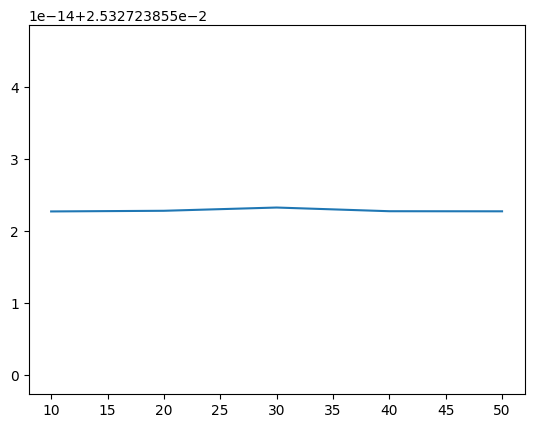

In [71]:
import matplotlib.pyplot as plt

X_axis = [10,20,30,40,50]

K_10_mean =  sum(K_10) / len(K_10)
K_20_mean =  sum(K_20) / len(K_20)
K_30_mean =  sum(K_30) / len(K_30)
K_40_mean =  sum(K_40) / len(K_40)
K_50_mean =  sum(K_50) / len(K_50)


print(K_10_mean,K_20_mean,K_30_mean,K_40_mean,K_50_mean)
Y_axis = [K_10_mean,K_20_mean,K_30_mean,K_40_mean,K_50_mean]

plt.plot(X_axis,Y_axis)
plt.show()

In [72]:
# 12.Also, report the TOP 10 products by User Sum Ratings.
# Most positively reviewed
user_rating = {}
for idx, headphone_review in PreProcesses_HeadPhones_df.iterrows():
    r_prod_id = headphone_review["asin"]
    if r_prod_id not in user_rating:
        user_rating[r_prod_id] = [0,0,0,0,0]
    user_rating[r_prod_id][int(headphone_review["overall"]) - 1] += 1


In [75]:
user_rating_sum = pd.DataFrame()
for prod_id in user_rating:
    ratingFreqList = user_rating[prod_id]
    Rating = ratingFreqList[0] + ratingFreqList[1] + ratingFreqList[2] + ratingFreqList[3] + ratingFreqList[4]
    user_rating_sum.at[0,prod_id] = Rating

C:\Users\hp\AppData\Local\Temp\ipykernel_11348\868603414.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  user_rating_sum.at[0,prod_id] = Rating
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\868603414.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  user_rating_sum.at[0,prod_id] = Rating
C:\Users\hp\AppData\Local\Temp\ipykernel_11348\868603414.py:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns

In [76]:
user_rating_sum

,4126895493,B000001OMR,B000001OMI,B00000DMA3,B00000J1EJ,B00000J1GA,B00000J1FV,B00000JBHP,B00000JCTD,B00001OPK7,...,B01HF20PU0,B01HG3CZJW,B01HGAVW9Y,B01HGNS59G,B01HHUFQOA,B01HI5SGRS,B01HI5YYN8,B01HI7D4VY,B01HI7O7KQ,B01HJ8E11E
0,49.0,11.0,41.0,11.0,50.0,12.0,6.0,66.0,6.0,7.0,...,7.0,9.0,6.0,7.0,21.0,6.0,30.0,44.0,66.0,41.0


In [81]:
top_10_users_rating = user_rating_sum.iloc[0].sort_values(ascending=False).head(10).index.tolist()

In [82]:
top_10_users_rating

['B004WODP20',
 'B00BN0N0LW',
 'B00LP6CFEC',
 'B00STP86CW',
 'B007FHX9OK',
 'B00EEHNNNG',
 'B00JJ2C0S0',
 'B000067RC4',
 'B003LPTAYI',
 'B00AWIPITS']